In [2]:
from skimage import color, io,filters,util,exposure, morphology
from skimage.transform import rescale
import numpy as np
import matplotlib.pyplot as plt
import math

In [3]:
path_bird = "Tugas Lab 2 - Images/Tugas Lab 2 - Images/bird.jpg"
path_insect = "Tugas Lab 2 - Images/Tugas Lab 2 - Images/insect.jpg"


# 1. Diberikan citra insect.jpg dengan ukuran 640 x 451 berikut ini
function list untuk nomer 1.

In [40]:
def smooting_Gaussianargs_1d(*kwargs):
    if len(kwargs)>1:
        returnVal = list(range(len(kwargs)))
        for i,val in enumerate(kwargs):
            returnVal[i] = util.img_as_ubyte(filters.gaussian(val,sigma=1))
        return returnVal
    else : 
        return util.img_as_ubyte(filters.gaussian(kwargs[0],sigma=1))

def sharpening_unsharp_mask_1d(*kwargs):
    if len(kwargs)>1:
        returnVal = list(range(len(kwargs)))
        for i,val in enumerate(kwargs):
            returnVal[i] = util.img_as_ubyte(filters.unsharp_mask(val))
        return returnVal
    else : 
        return util.img_as_ubyte(filters.unsharp_mask(kwargs[0]))
        

def convert_unit_img(img_3d_input,number_of_color):
        for i in range(number_of_color):
            try :    
                img_3d_input[:,:,i]=util.img_as_ubyte(img_3d_input[:,:,i])
            except ValueError :
                for j in img_3d_input[:,:,i]:
                    for k in j:
                        k=int(k)
        return img_3d_input

## a.Terapkan smoothing terhadap ketiga channel R, G dan B lalu tampilkan hasilnya sebagai satu citra


In [5]:
img_RGB_insect  = io.imread(path_insect)
R,G,B = img_RGB_insect [:,:,0],img_RGB_insect [:,:,1],img_RGB_insect [:,:,2]
R_smoot,G_smoot,B_smoot = smooting_args_1d(R,G,B)
img_RGB_insect_sv = np.copy(img_RGB_insect )
img_RGB_insect_sv[:,:,0], img_RGB_insect_sv[:,:,1], img_RGB_insect_sv[:,:,2] = R_smoot, G_smoot, B_smoot



(-0.5, 639.5, 450.5, -0.5)

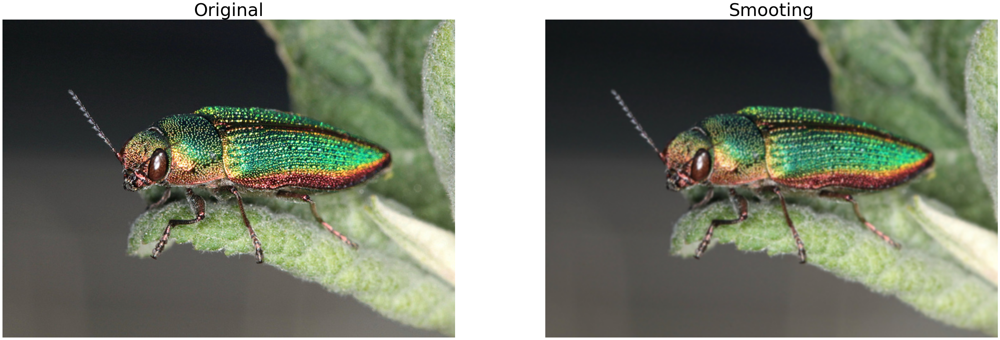

In [6]:
fig,axs= plt.subplots(nrows=1,ncols=2, figsize=(50, 20))
axs[0].imshow(img_RGB_insect)
axs[0].set_title("Original",size=50)
axs[0].axis('off')
axs[1].imshow(img_RGB_insect_s,cmap='gray',vmin=0,vmax=255)
axs[1].set_title("Smooting",size=50)
axs[1].axis('off')


## b.Terapkan smoothing terhadap V lalu tampilkan hasilnya, ubah citra HSV menjadi RGB terlebih dahulu sebelum ditampilkan


In [49]:
img_HSV_insect= color.rgb2hsv(img_RGB_insect)
V = img_HSV_insect[:,:,2]
V_smoot= smooting_args_1d(V)
img_HSV_insect_s = np.copy(img_HSV_insect)
img_HSV_insect_s[:,:,2]= V_smoot
img_RGB_insect_sv=np.copy(img_RGB_insect)
img_RGB_insect_sv=convert_unit_img(img_RGB_insect_sv,3)
img_RGB_insect_sv=color.hsv2rgb(img_RGB_insect_sv)

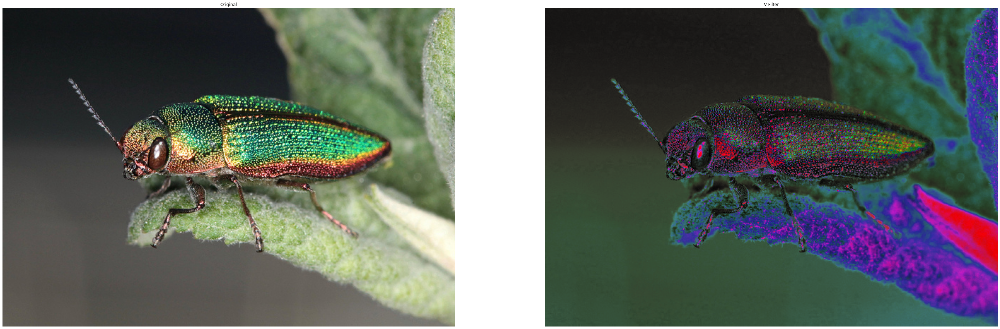

In [50]:
plt.figure(figsize=(50, 20));
plt.subplot(1,2,1);plt.imshow(img_RGB_insect); plt.title('Original');
plt.axis('off');
plt.subplot(1,2,2);plt.imshow(img_RGB_insect_sv,cmap='gray',vmin=0,vmax=255);
plt.title('V Filter'); plt.axis('off');

## c.Ceritakan perbedaan dari citra awal, citra hasil smoothing channel RGB dan citra hasil smoothing channel V

## d.Terapkan sharpening terhadap ketiga channel R, G dan B lalu tampilkan hasilnya sebagai satu citra

In [64]:
img_RGB_insect  = io.imread(path_insect)
R,G,B = img_RGB_insect [:,:,0],img_RGB_insect [:,:,1],img_RGB_insect [:,:,2]
R_smoot,G_smoot,B_smoot =sharpening_unsharp_mask_1d(R,G,B)
img_RGB_insect_sh = np.copy(img_RGB_insect )
img_RGB_insect_s[:,:,0], img_RGB_insect_s[:,:,1], img_RGB_insect_s[:,:,2] = R_smoot, G_smoot, B_smoot


(-0.5, 639.5, 450.5, -0.5)

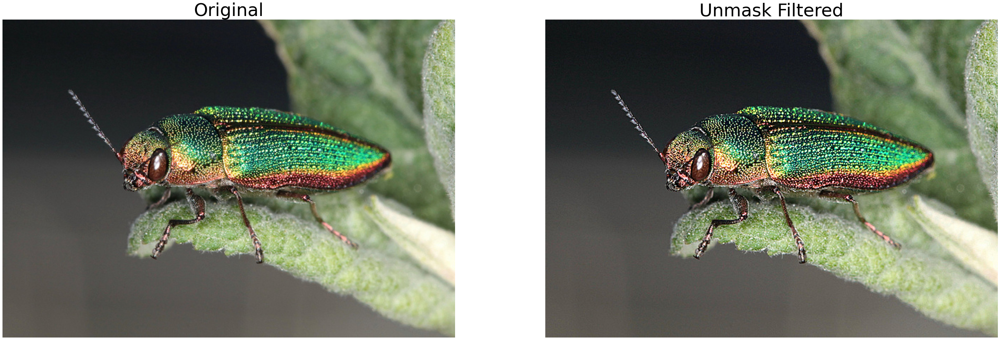

In [65]:
fig,axs= plt.subplots(nrows=1,ncols=2, figsize=(50, 20))
axs[0].imshow(img_RGB_insect)
axs[0].set_title("Original",size=50)
axs[0].axis('off')
axs[1].imshow(img_RGB_insect_s,vmin=0,vmax=255)
axs[1].set_title("Unmask Filtered",size=50)
axs[1].axis('off')

## e. Terapkan sharpening terhadap channel V lalu tampilkan hasilnya, ubah citra HSV menjadi RGB terlebih dahulu sebelum ditampilkan

In [54]:
img_HSV_insect= color.rgb2hsv(img_RGB_insect)
V = img_HSV_insect[:,:,2]
V_smoot= sharpening_unsharp_mask_1d(V)
img_HSV_insect_sh = np.copy(img_HSV_insect)
img_HSV_insect_sh[:,:,2]= V_smoot
img_RGB_insect_sh=np.copy(img_RGB_insect)
img_RGB_insect_sh=convert_unit_img(img_RGB_insect_sv,3)
img_RGB_insect_sh=color.hsv2rgb(img_RGB_insect_sh)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 639.5, 450.5, -0.5)

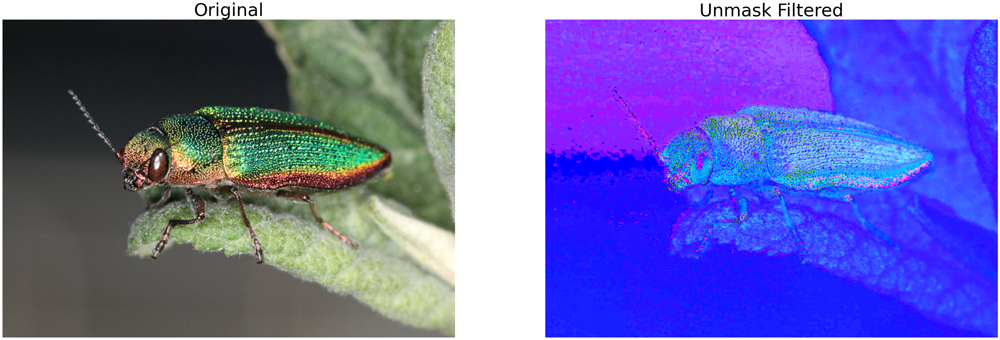

In [61]:
fig,axs= plt.subplots(nrows=1,ncols=2, figsize=(50, 20))
axs[0].imshow(img_RGB_insect)
axs[0].set_title("Original",size=50)
axs[0].axis('off')
axs[1].imshow(img_HSV_insect_sh,vmin=0,vmax=255)
axs[1].set_title("Unmask Filtered",size=50)
axs[1].axis('off')


## f. Ceritakan perbedaan dari citra awal, citra hasil sharpening channel RGB dan citra hasil sharpening channel V

# 2. Diberikan citra bird.jpg dengan ukuran 1280 x 914 berikut ini

In [ ]:

def contrastStretching(args):
    mn = min(args.flatten())
    mx = max(args.flatten())
    b = int(np.floor(255 / (mx - mn)))
    return (args - mn) * b

def CS_id(*kwargs):
    if len(kwargs)>1:
            returnVal = list(range(len(kwargs)))
            for i,val in enumerate(kwargs):
                returnVal[i] = contrastStretching(val)
            return returnVal
        else : 
            return contrastStretching(kwargs[0])

## a. Terapkan contrast stretching terhadap ketiga channel R, G dan B lalu tampilkan hasilnya sebagai satu citra


In [63]:
img_RGB_bird  = io.imread(path_bird)
R,G,B = img_RGB_bird [:,:,0],img_RGB_bird [:,:,1],img_RGB_bird [:,:,2]
R_smoot,G_smoot,B_smoot = smooting_args_1d(R,G,B)
img_RGB_bird_sv = np.copy(img_RGB_bird )
img_RGB_bird_sv[:,:,0], img_RGB_bird_sv[:,:,1], img_RGB_bird_sv[:,:,2] = R_smoot, G_smoot, B_smoot


(-0.5, 1279.5, 913.5, -0.5)

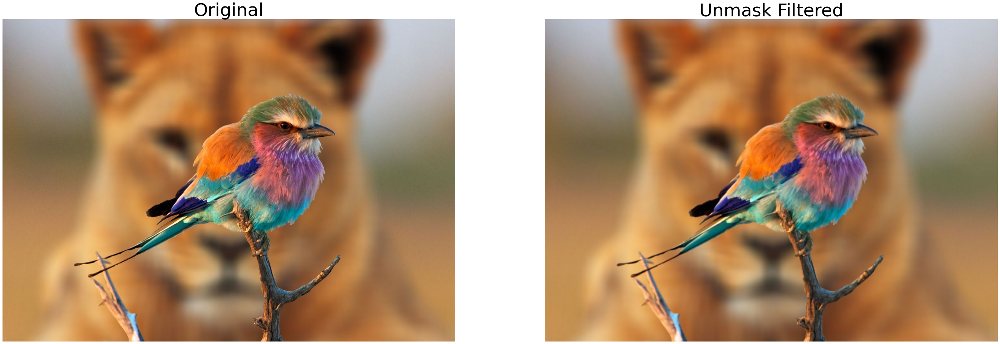

In [66]:
fig,axs= plt.subplots(nrows=1,ncols=2, figsize=(50, 20))
axs[0].imshow(img_RGB_bird)
axs[0].set_title("Original",size=50)
axs[0].axis('off')
axs[1].imshow(img_RGB_bird_sv,vmin=0,vmax=255)
axs[1].set_title("Unmask Filtered",size=50)
axs[1].axis('off')

## b. Terapkan contrast stretching terhadap channel V lalu tampilkan hasilnya, ubah citra HSV menjadi RGB terlebih dahulu sebelum ditampilkan 


## c. Ceritakan perbedaan dari citra awal, citra hasil contrast stretching channel RGB dan citra hasil contrast stretching channel V (hint: gunakan histogram untuk menunjukkan perbedaan)


## d. Terapkan histogram equalization terhadap ketiga channel R, G dan B lalu tampilkan hasilnya sebagai satu citra


## e. Terapkan histogram equalization terhadap channel V lalu tampilkan hasilnya sebagai, ubah citra HSV menjadi RGB terlebih dahulu sebelum ditampilkan


## f. Ceritakan perbedaan dari citra awal, citra hasil histogram equalization channel RGB dan citra hasil histogram equalization channel V (hint: gunakan histogram untuk menunjukkan perbedaan)